reshape position embedding from 576 to 1024
load checkpoint from /data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth


Loading pipeline components...: 100%|██████████| 5/5 [00:00<00:00,  8.06it/s]


a car driving down a city street near buildings


100%|██████████| 22/22 [00:03<00:00,  5.71it/s]


some cars on the road in a residential area


100%|██████████| 22/22 [00:03<00:00,  5.72it/s]


the car is driving on the road in the game


100%|██████████| 22/22 [00:03<00:00,  5.71it/s]


the back end of a car driving on a road in the rain


100%|██████████| 22/22 [00:03<00:00,  5.72it/s]


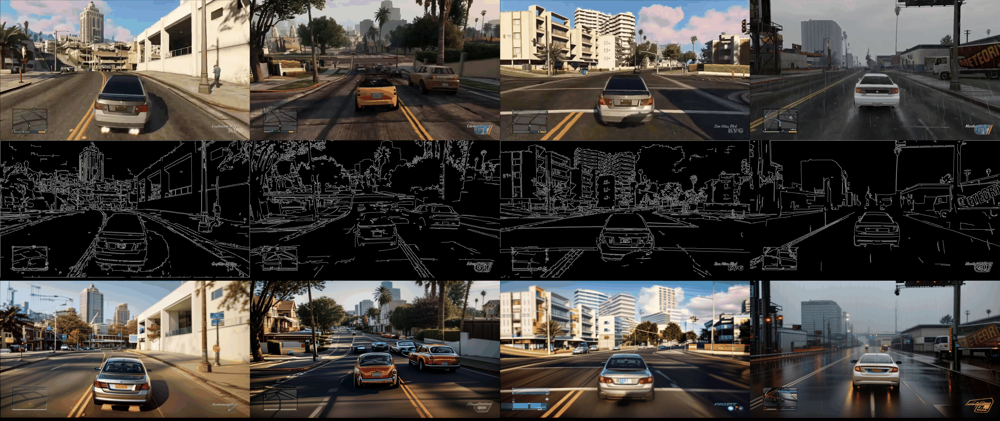

In [6]:
import os
import cv2
import torch
import numpy as np
from diffusers import AutoencoderKL, ControlNetModel, MotionAdapter
from diffusers.pipelines import RerenderAVideoPipeline
from diffusers.schedulers import DDIMScheduler
from transformers import CLIPVisionModelWithProjection, CLIPImageProcessor
from PIL import Image as PILImage
from controlnet_aux import CannyDetector
from diffusers.utils import export_to_gif, make_image_grid
from IPython.display import display, Image
from diffusers.blip import blip_decoder
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode

device = "cuda:2"
torch.cuda.set_device(device)
generator = torch.Generator().manual_seed(100)


def extract_frame(video_path):
    images = []
    frames = []
    cap = cv2.VideoCapture(video_path)
    canny = CannyDetector()

    while True:
        ret, frame = cap.read()

        if not ret:
            break

        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame = PILImage.fromarray(frame)

        images.append(frame)

        frames.append(
            canny(
                frame,
                detect_resolution=frame.height,
                image_resolution=frame.height,
                low_threshold=50,
                high_threshold=150,
            )
        )
    cap.release()
    return images, frames


def load_demo_image(image, image_size, device):
    w, h = image.size
    # display(raw_image.resize((w//5,h//5)))

    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
        ]
    )
    image = transform(image).unsqueeze(0).to(device)
    return image


model = blip_decoder(
    pretrained="/data/noah/ckpt/pretrain_ckpt/BLIP/model_large_caption.pth", image_size=512, vit="large"
)
model.eval()
model = model.to(device)

# controlnet = ControlNetModel.from_pretrained(
#     "/data/noah/ckpt/finetuning/Control_Canny_SD_AD", torch_dtype=torch.float16
# ).to(device)

controlnet = ControlNetModel.from_pretrained(
    "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/controlnet_canny", torch_dtype=torch.float16
).to(device)

model_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/rv"
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=torch.float16).to(device)

pipe = RerenderAVideoPipeline.from_pretrained(
    model_id,
    controlnet=controlnet,
    vae=vae,
)
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    beta_schedule="linear",
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    steps_offset=1,
)
pipe.scheduler = scheduler

lora_id = "/data/noah/ckpt/pretrain_ckpt/StableDiffusion/lora_detail"
lora_name = "add_detail.safetensors"
pipe.load_lora_weights(lora_id, weight_name=lora_name)

# freeinit_filters = [
#     dict(
#         method="gaussian",
#         spatial_stop_frequency=0.25,
#         temporal_stop_frequency=0.25,
#     ),
#     dict(
#         method="butterworth",
#         order=4,
#         spatial_stop_frequency=0.25,
#         temporal_stop_frequency=0.25,
#     ),
#     dict(
#         method="butterworth",
#         order=4,
#         spatial_stop_frequency=0.4,
#         temporal_stop_frequency=0.4,
#     ),
#     dict(
#         method="butterworth",
#         order=4,
#         spatial_stop_frequency=0.25,
#         temporal_stop_frequency=0.25,
#         use_fast_sampling=True,
#     ),
# ]

# filter = freeinit_filters[1]
# pipe.enable_free_init(**filter, generator=generator)
# pipe.enable_freeu(s1=0.9, s2=0.2, b1=1.2, b2=1.4)
pipe.enable_vae_slicing()
pipe.enable_vae_tiling()

pipe = pipe.to(device=device, dtype=torch.float16)

video_paths = "/data/noah/inference/simulation/incabin_sample/reference_vid"
video_out_path = "/data/noah/inference/simulation/incabin_sample/out/grid.gif"

result_images = []
input_images = []
control_images = []
sample_cnt = 16
resolution = (768, 512)


for video_path in os.listdir(video_paths):
    video_path = os.path.join(video_paths, video_path)
    images, conditioning_frames = extract_frame(video_path)
    images = images[:sample_cnt]
    conditioning_frames = conditioning_frames[:sample_cnt]

    blip_image = load_demo_image(image=images[0], image_size=512, device=device)
    with torch.no_grad():
        caption = model.generate(blip_image, sample=True, top_p=0.9, max_length=20, min_length=5)[0]
        print(caption)

    prompt = "{}, outdoor, best quality, extremely detailed, clearness, naturalness, film grain, crystal clear, photo with color, actuality".format(
        caption
    )
    negative_prompt = "cartoon, anime, painting, disfigured, immature, blur, picture, 3D, render, semi-realistic, drawing, poorly drawn, bad anatomy, wrong anatomy, gray scale, worst quality, low quality, sketch"

    frames = pipe(
        prompt,
        [image.resize(resolution) for image in images],
        [con_image.resize(resolution) for con_image in conditioning_frames],
        num_inference_steps=40,
        strength=0.55,
        controlnet_conditioning_scale=0.75,
        generator=generator,
        warp_start=0.0,
        warp_end=0.1,
        mask_start=0.5,
        mask_end=0.8,
        mask_strength=0.7,
        negative_prompt=negative_prompt,
    ).frames

    new_w, new_h = conditioning_frames[0].width, conditioning_frames[0].height
    for idx, f in enumerate(frames):
        frames[idx] = f.resize((new_w, new_h))

    input_images.append(images)
    control_images.append(conditioning_frames)
    result_images.append(frames)

grids = []
result_images = np.array(result_images).astype("uint8")
input_images = np.array(input_images).astype("uint8")
control_images = np.array(control_images).astype("uint8")
num_video = len(os.listdir(video_paths))

for idx in range(sample_cnt):
    sub_result_images = [PILImage.fromarray(r) for r in result_images[:, idx, ...]]
    sub_input_images = [PILImage.fromarray(i) for i in input_images[:, idx, ...]]
    sub_control_images = [PILImage.fromarray(c) for c in control_images[:, idx, ...]]

    image_grid = make_image_grid(sub_input_images, rows=1, cols=num_video)
    condition_grid = make_image_grid(sub_control_images, rows=1, cols=num_video)
    result_grid = make_image_grid(sub_result_images, rows=1, cols=num_video)
    grid = make_image_grid([image_grid, condition_grid, result_grid], rows=3, cols=1)
    grids.append(grid.resize((grid.width // 2, grid.height // 2)))

export_to_gif(grids, video_out_path)
display(Image(video_out_path))